<a href="https://colab.research.google.com/github/aeksei/test_colab/blob/main/kgiop_objects_geopandas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install geopandas

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [ ]:
DRIVE_FILE_ID = "1kdqgi94qhdEVvOJAvlpHvurYcurh_5d9"
url = f"https://drive.google.com/uc?export=download&id={DRIVE_FILE_ID}"

df_kgiop_objects = gpd.read_file(url)
df_kgiop_objects.head()

,id,ensemble_name,object_name,occurrence_time,object_location,historical_category,normative_act,object_type,geometry
0,1,—,Здание Консисторского управления Могилевской Р...,1870-1873; 1878-1879; 1896-1897; 1900-1902,"1-я Красноармейская ул., 11, лит. А, Б",объект культурного наследия регионального знач...,Распоряжение КГИОП № 10-22 от 21.07.2009,Памятник,POINT (3374338.001 8381192.049)
1,2,—,Здание манежа (экзерциргауса) лейб-гвардии Изм...,1795-1797,"1-я Красноармейская ул., 13; Измайловский пр.,...",объект культурного наследия регионального знач...,Закон Санкт-Петербурга № 141-47 от 02.07.1997,Памятник,POINT (3373995.026 8381101.886)
2,3,—,"Дом, где в начале 1895 г. Ленин В.И. встречалс...",—,"1-я Красноармейская ул., 22",объект культурного наследия регионального знач...,Закон Санкт-Петербурга № 141-47 от 02.07.1997,Памятник,POINT (3374182.710 8381041.925)
3,4,—,Трансформаторная подстанция,1906-1907,"11-я Красноармейская ул., 28",объект культурного наследия регионального знач...,Решение исполкома Ленгорсовета № 963 от 05.12....,Памятник,POINT (3372847.990 8380161.229)
4,5,—,Манеж графа Г.И. Рибопьера (Здание Санкт-Петер...,1887; 1891,"2-я Красноармейская ул., 12",объект культурного наследия регионального знач...,Распоряжение КГИОП № 10-26 от 15.09.2009,Памятник,POINT (3374362.046 8380882.255)


In [ ]:
DRIVE_FILE_ID = "1bUT1E-QSbG1vpSNM2dOG2-LEVXSrPdo3"
url = f"https://drive.google.com/uc?export=download&id={DRIVE_FILE_ID}"

df_roads = gpd.read_file(url)
df_roads.head()

,type,id,tags,geometry
0,way,4078548,"{'foot': 'no', 'highway': 'residential', 'lane...","LINESTRING (3385685.754 8387961.891, 3385692.2..."
1,way,4414959,"{'highway': 'residential', 'lanes': '2', 'lit'...","LINESTRING (3386560.825 8339904.673, 3386543.1..."
2,way,4414960,"{'highway': 'residential', 'lanes': '2', 'lit'...","LINESTRING (3386296.074 8339493.502, 3386326.1..."
3,way,4414988,"{'foot': 'no', 'highway': 'secondary', 'lanes'...","LINESTRING (3385061.151 8336249.836, 3385080.0..."
4,way,4454283,"{'foot': 'no', 'highway': 'secondary', 'lanes'...","LINESTRING (3372067.473 8403184.190, 3372225.9..."


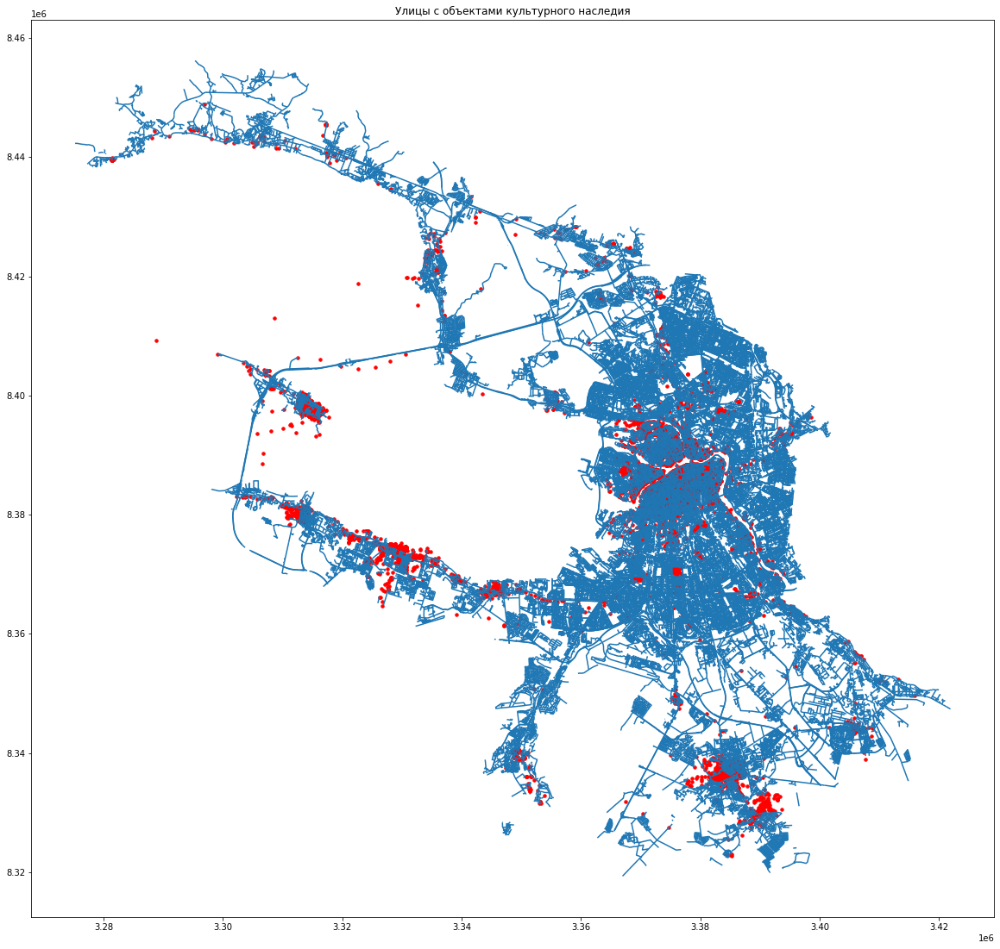

In [ ]:
# bbox = df_kgiop_objects.unary_union.envelope
# df_roads = df_roads[df_roads.within(bbox)]

fig, ax = plt.subplots(figsize=(20, 20))
ax.set_aspect('equal')

df_roads.plot(ax=ax)
df_kgiop_objects.plot(ax=ax, marker='o', color='red', markersize=12)

plt.title("Улицы с объектами культурного наследия")
plt.show()

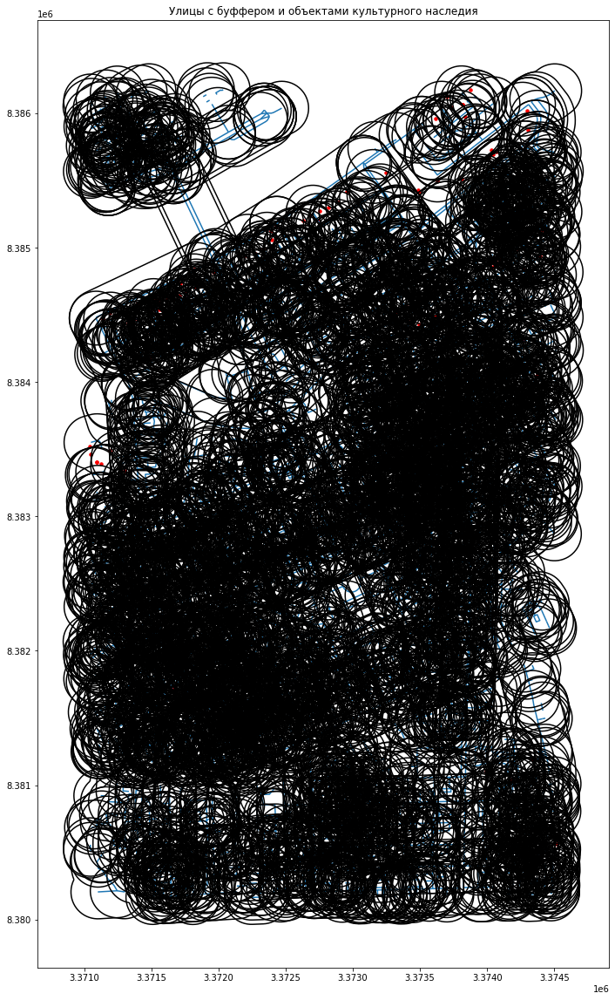

In [ ]:
ROAD_BUFFER = 80

fig, ax = plt.subplots(figsize=(20, 20))
ax.set_aspect('equal')

df_roads.plot(ax=ax)
df_kgiop_objects.plot(ax=ax, marker='o', color='red', markersize=12)
df_roads.geometry.buffer(ROAD_BUFFER).boundary.plot(ax=ax, edgecolor='black')

plt.title("Улицы с буффером и объектами культурного наследия")
plt.show()

In [ ]:
df_roads["contains_kgiop_objects"] = df_roads["geometry"].apply(lambda road: sum(df_kgiop_objects["geometry"].within(road.buffer(ROAD_BUFFER))))
df_roads["contains_kgiop_objects"].value_counts()

0     983
1      86
2      28
4      11
3      11
5       5
6       3
15      2
9       2
7       2
20      1
12      1
Name: contains_kgiop_objects, dtype: int64

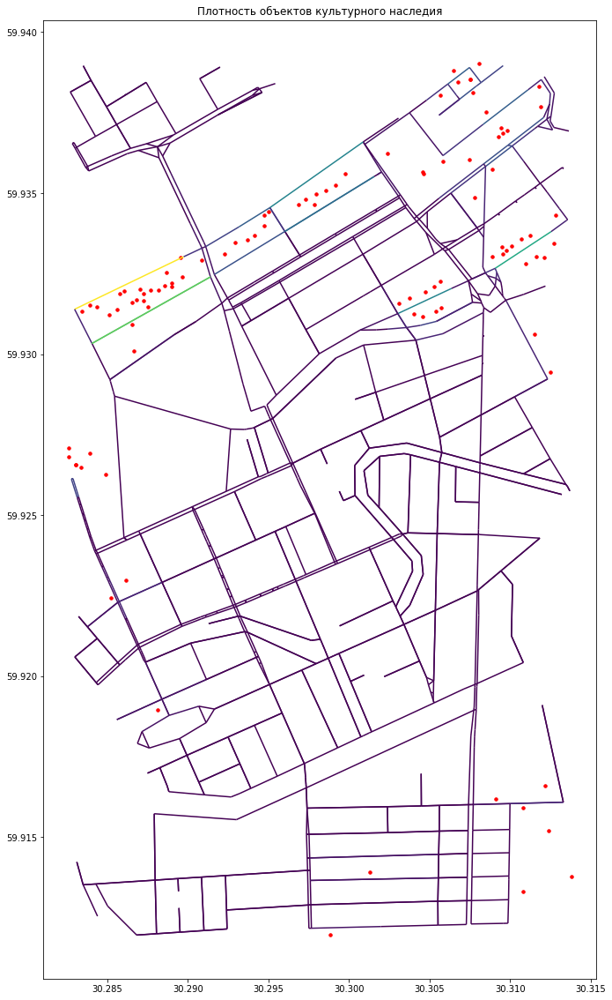

In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))
ax.set_aspect('equal')

df_roads.plot(ax=ax, column="contains_kgiop_objects")
df_kgiop_objects.plot(ax=ax, marker='o', color='red', markersize=12)

plt.title("Плотность объектов культурного наследия")
plt.show()

In [ ]:
import pandas as pd
import plotly.express as px

url = f"https://drive.google.com/uc?export=download&id=11AIX7aAqyG_tS5Khkrdm1H28pmH3ii_F"  # contains_kgiop_objects_4326

df_4326 = pd.read_json(url, orient="index")

In [ ]:
px.bar(df_4326, x=df_4326.index, y=0, log_y=True)

# ROAD BUFFER

In [ ]:
import pandas as pd
import plotly.express as px

from tqdm import tqdm
tqdm.pandas()

# from pandarallel import pandarallel
# pandarallel.initialize(progress_bar=True)

In [ ]:
K_MEAN_POINTS = 5
# mean_distance = df_roads.geometry.parallel_apply(lambda road: df_kgiop_objects.distance(road).nsmallest(K_MEAN_POINTS).mean())

In [ ]:
url = f"https://drive.google.com/uc?export=download&id=18WfZTor3jqtGybrQEjGRFUZR6vMi0_sx"  # k_mean_points_distance

k_mean_points_distance_series = pd.read_json(url, orient="index")
k_mean_points_distance_series.head()

,0
4078548,265.639446
4414959,1514.902312
4414960,1034.002188
4414988,98.780964
4454283,620.641770


In [ ]:
k_mean_points_distance_series.rename(columns={0: "mean_distance"}, inplace=True)
k_mean_points_distance_series.sort_values(by="mean_distance", inplace=True)

k_mean_points_distance_series.head()

,mean_distance
958904560,2.696025
863159526,4.459593
189092967,4.971158
192117405,7.095810
863159565,8.083646


In [ ]:
px.scatter(k_mean_points_distance_series, y="mean_distance")

In [ ]:
px.histogram(k_mean_points_distance_series, x="mean_distance", nbins=250)

In [ ]:
distance_less_1000 = k_mean_points_distance_series[k_mean_points_distance_series["mean_distance"] < 1000]


In [ ]:
px.histogram(distance_less_1000, x="mean_distance", nbins=250)

In [ ]:
px.violin(k_mean_points_distance_series[k_mean_points_distance_series["mean_distance"] < 250], y="mean_distance", box=True)

In [ ]:
px.violin(k_mean_points_distance_series[k_mean_points_distance_series["mean_distance"] < 500], y="mean_distance", box=True)

In [ ]:
px.violin(k_mean_points_distance_series, y="mean_distance", box=True)

In [ ]:
import plotly.graph_objects as go


In [ ]:
# 

In [ ]:
data = [k_mean_points_distance_series[k_mean_points_distance_series["mean_distance"] < less] for less in [1000, 500, 250]]
data.insert(0, k_mean_points_distance_series)

names = ["all", "1000", "500", "250"]

fig = go.Figure()
for data_line, name in zip(data, names):
    fig.add_trace(go.Violin(x=data_line["mean_distance"], name=name))

fig.update_traces(orientation="h", side="positive", width=3, points=False)
fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False, title="Среднее растояние до 5 ближайших объектов культурного наследия")
fig.update_yaxes(type="category")

fig.show()

In [ ]:
import plotly.graph_objects as go
from plotly.colors import n_colors
import numpy as np
np.random.seed(1)

# 12 sets of normal distributed random data, with increasing mean and standard deviation
data = (np.linspace(1, 2, 12)[:, np.newaxis] * np.random.randn(12, 200) +
            (np.arange(12) + 2 * np.random.random(12))[:, np.newaxis])

colors = n_colors('rgb(5, 200, 200)', 'rgb(200, 10, 10)', 12, colortype='rgb')

fig = go.Figure()
for data_line, color in zip(data, colors):
    fig.add_trace(go.Violin(x=data_line, line_color=color))

fig.update_traces(orientation='h', side='positive', width=3, points=False)
fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False)
fig.show()

In [ ]:
gdf_roads_crs84 = df_roads.to_crs(epsg=4326)

In [ ]:
gdf_roads_crs84 = gdf_roads_crs84.iloc[:10000]
gdf_roads_crs84

NameError: ignored

In [ ]:
import plotly.express as px
import geopandas as gpd

In [ ]:
fig = px.choropleth_mapbox(
    gdf_roads_crs84,
    geojson=gdf_roads_crs84.geometry,
    locations=gdf_roads_crs84.index,
    center={"lat": 45.5517, "lon": -73.7073},
    mapbox_style="carto-positron",
    zoom=8.5
)
fig.show()

In [ ]:
gdf_roads_crs84.set_index("id", inplace=True)
gdf_roads_crs84

,type,tags,geometry
id,,,
4078548,way,"{'foot': 'no', 'highway': 'residential', 'lane...","LINESTRING (30.41413 59.94706, 30.41419 59.947..."
4414959,way,"{'highway': 'residential', 'lanes': '2', 'lit'...","LINESTRING (30.42199 59.73016, 30.42183 59.730..."
4414960,way,"{'highway': 'residential', 'lanes': '2', 'lit'...","LINESTRING (30.41962 59.72830, 30.41989 59.728..."
4414988,way,"{'foot': 'no', 'highway': 'secondary', 'lanes'...","LINESTRING (30.40852 59.71361, 30.40869 59.71355)"
4454283,way,"{'foot': 'no', 'highway': 'secondary', 'lanes'...","LINESTRING (30.29180 60.01548, 30.29322 60.015..."
...,...,...,...
85515496,way,"{'highway': 'service', 'surface': 'asphalt'}","LINESTRING (30.31605 59.95959, 30.31602 59.959..."
85515497,way,"{'highway': 'service', 'surface': 'asphalt'}","LINESTRING (30.31645 59.95909, 30.31637 59.959..."
85515498,way,{'highway': 'service'},"LINESTRING (30.31576 59.95982, 30.31583 59.959..."


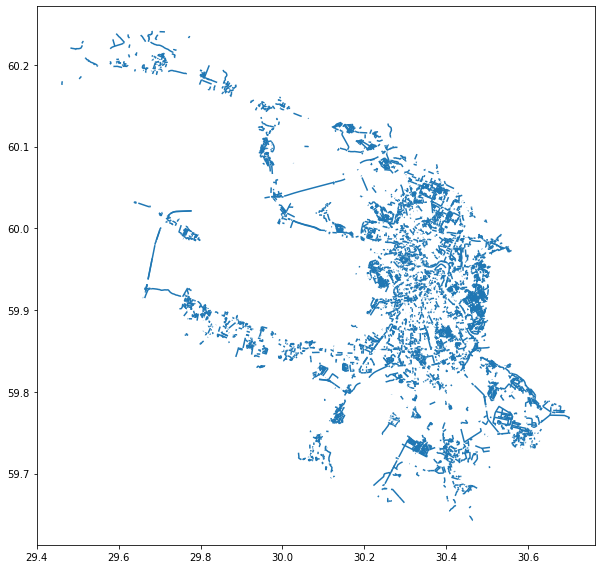

In [ ]:
gdf_roads_crs84.plot(figsize=(10,10))

In [ ]:
!pip install folium matplotlib mapclassify

In [ ]:
gdf_roads_crs84.explore()

TypeError: ignored

In [ ]:
import geopandas

nybb = geopandas.read_file(geopandas.datasets.get_path('nybb'))
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))
cities = geopandas.read_file(geopandas.datasets.get_path('naturalearth_cities'))

In [ ]:
nybb.explore()

In [ ]:
!pip install folium -U

     |████████████████████████████████| 95 kB 2.2 MB/s 
  Attempting uninstall: folium
    Found existing installation: folium 0.8.3
    Uninstalling folium-0.8.3:
      Successfully uninstalled folium-0.8.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.12.1.post1 which is incompatible.


In [ ]:
df_kgiop_objects.explore()